# Imports

In [1]:
import scanpy as sc

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.style as style
import matplotlib

import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

# utils function -- helper functions for plotting
import sys
sys.path.append('../../utils/')
import figure_utils as figure_utils

In [2]:
# create figures directory
import os

directory_path = 'figures'
if not os.path.exists(directory_path):
    # If not, create the directory
    os.makedirs(directory_path)
    print(f"Directory '{directory_path}' created successfully.")
else:
    print(f"Directory '{directory_path}' already exists.")

Directory 'figures' already exists.


# Plot aesthetics

In [2]:
%matplotlib inline
matplotlib.rcParams['figure.dpi'] = 500 # 150 dpi resolution
matplotlib.rcParams['image.cmap'] = 'Spectral_r' # preferred color map
# matplotlib.rcParams['figure.figsize'] = [6, 6] # Square
# no bounding boxes or axis:
matplotlib.rcParams['axes.spines.bottom'] = "off"
matplotlib.rcParams['axes.spines.top'] = "off"
matplotlib.rcParams['axes.spines.left'] = "off"
matplotlib.rcParams['axes.spines.right'] = "off"

In [3]:
# UMAP PARAMS
DOT_SIZE = 25
LEGEND_FONTSIZE = 8
LEGEND_FONTOUTLINE = 1
UMAP_FIGSIZE = (10,10)

# SEXES COLOR
# HERM_COLOR = '#f58020'
# MALE_COLOR = '#1479b8'
# SHARED_SEX_COLOR = '#c2b69b'

# SEXES COLOR -- NEW
HERM_COLOR = '#ff8b00'
MALE_COLOR = '#2258a5'
SHARED_SEX_COLOR = '#349c55'

# SHEATH/SOCKET COLORS
# SHEATH_COLOR = '#a5444b'
# SOCKET_COLOR = '#bfbaba'

# DEAFULT teal brown
# SHEATH_COLOR = '#008080'
# SOCKET_COLOR = '#8B4513'

# lighter teal -- EQ
SHEATH_COLOR = '#3ac9c9' # '#369e9e'
SOCKET_COLOR = '#c47841'

# teal magenta

# lighter teal brown
# SHEATH_COLOR = '#00CED1'
# SOCKET_COLOR = '#D2691E'

# HEATMAP COLOR AESTHETICS
PLOTLY_COLOR_TEMPLATE = 'plotly_white'
HEATMAP_COLOR = [[0,'rgb(250,250,250)'], [1,'rgb(102,0,204)']]
HEATMAP_MIN_COLOR = 0
HEATMAP_MAX_COLOR = 4

# Load Data

In [4]:
adata = sc.read('../../data/GliaOnly.h5ad')
adata

AnnData object with n_obs × n_vars = 20810 × 12376
    obs: 'Celltype', 'sex_specificity', 'leiden_postBC', 'sex', 'SheathSocket_label', 'Compartments', 'leiden_preBC', 'cluster_sex_label', 'Cluster_Celltype'
    var: 'highly_variable', 'previous_highly_variable', 'transcription_factors', 'transporters', 'neuropeptides', 'gene_ids'
    uns: 'BatchCorrected_LeidenClusters_colors', 'Celltype_colors', 'Cluster_Celltype_colors', 'Compartments_colors', 'FiguresData_Sheath_Selection_Results', 'FiguresData_Socket_Selection_Results', 'SheathSocket_L2_GeneRanking_Order', 'SheathSocket_Probability_Estimates', 'SheathSocket_label_colors', 'Validations_colors', 'cluster_sex_label_colors', 'dendrogram_Cluster_Celltype', 'gene_validations', 'leiden_noBC_colors', 'leiden_postBC_colors', 'sex_colors', 'sex_frac_Glia_postBC', 'sex_specificity_colors'
    obsm: 'DM_EigenVectors_postBC', 'X_pca', 'X_pca_harmony', 'X_umap', 'X_umap_noBC'
    varm: 'cluster_means', 'pairwise_cluster_count'
    layers: 'mag

# SFig 2A -- Sex Fractions Per Cluster

In [5]:
sex_frac = adata.uns['sex_frac_Glia_postBC'].copy()
sex_frac['leiden_postBC'] = sex_frac['leiden_postBC'].astype(str)
sex_frac.head()

,leiden_postBC,Herm,Male,Herm_pct,Male_pct
0,0,1863,72,0.962791,0.037209
1,1,49,1767,0.026982,0.973018
2,2,1492,254,0.854525,0.145475
3,3,1254,447,0.737213,0.262787
4,4,1441,159,0.900625,0.099375


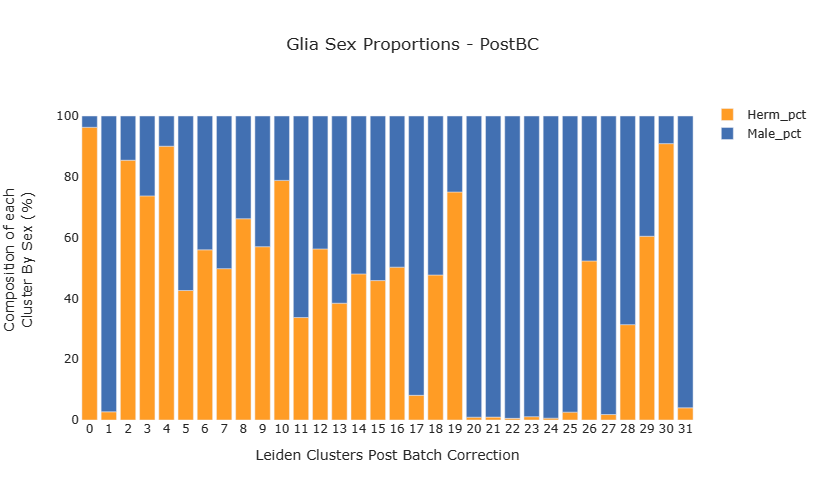

In [6]:
# plot the fractions stored in the data
fig_frac = go.Figure()
bar_colors = {'Male_pct':MALE_COLOR, 'Herm_pct':HERM_COLOR}

for sex in ['Herm_pct','Male_pct']:
    fig_frac.add_traces(
        go.Bar(
            x=sex_frac.loc[:,'leiden_postBC'],
            y=sex_frac.loc[:,sex] * 100,
            name=sex,
            marker_color=bar_colors[sex]
        )
    )
fig_frac.update_traces(
    opacity=0.85
)
fig_frac.update_layout(
    template='seaborn',
    width=1500,
    height=500,
    barmode='relative',
    hovermode='x unified',
    xaxis=dict(title='Leiden Clusters Post Batch Correction',showgrid=False),
    yaxis=dict(title='Composition of each<br>Cluster By Sex (%)',showgrid=False),
    plot_bgcolor='rgba(0,0,0,0)',
    title=dict(text='Glia Sex Proportions - PostBC')
)
fig_frac.show()
fig_frac.write_image('figures/S2A_GliaPostBC_ClusterSex_proportion.png')
fig_frac.write_html('figures/S2A_GliaPostBC_ClusterSex_proportion.html')

# SFig 2B -- Pairwise Cluster 10

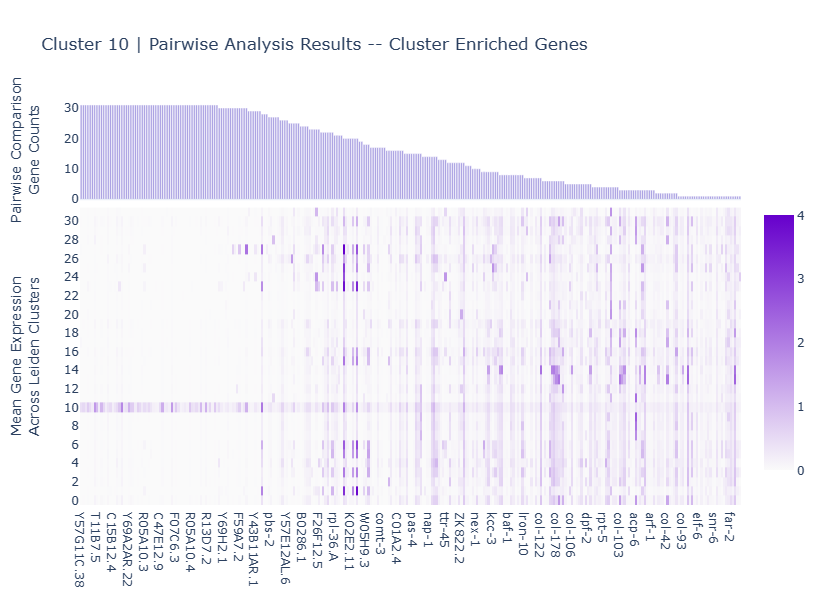

In [7]:
figure_utils.get_pairwise_results(ad_data=adata, cluster_id='10', filename='figures/pairwisefigure_S2B_Cluster10')

# SFig 2C -- Pairwise Genes

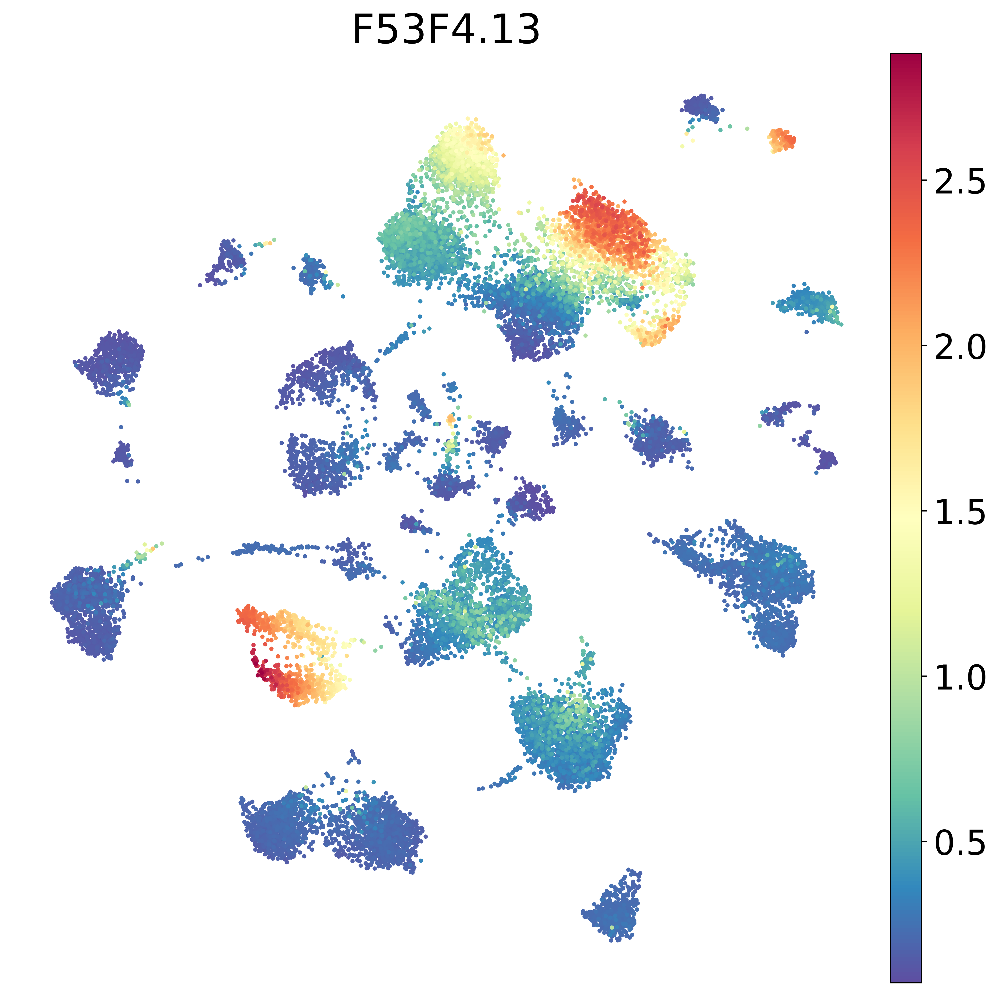

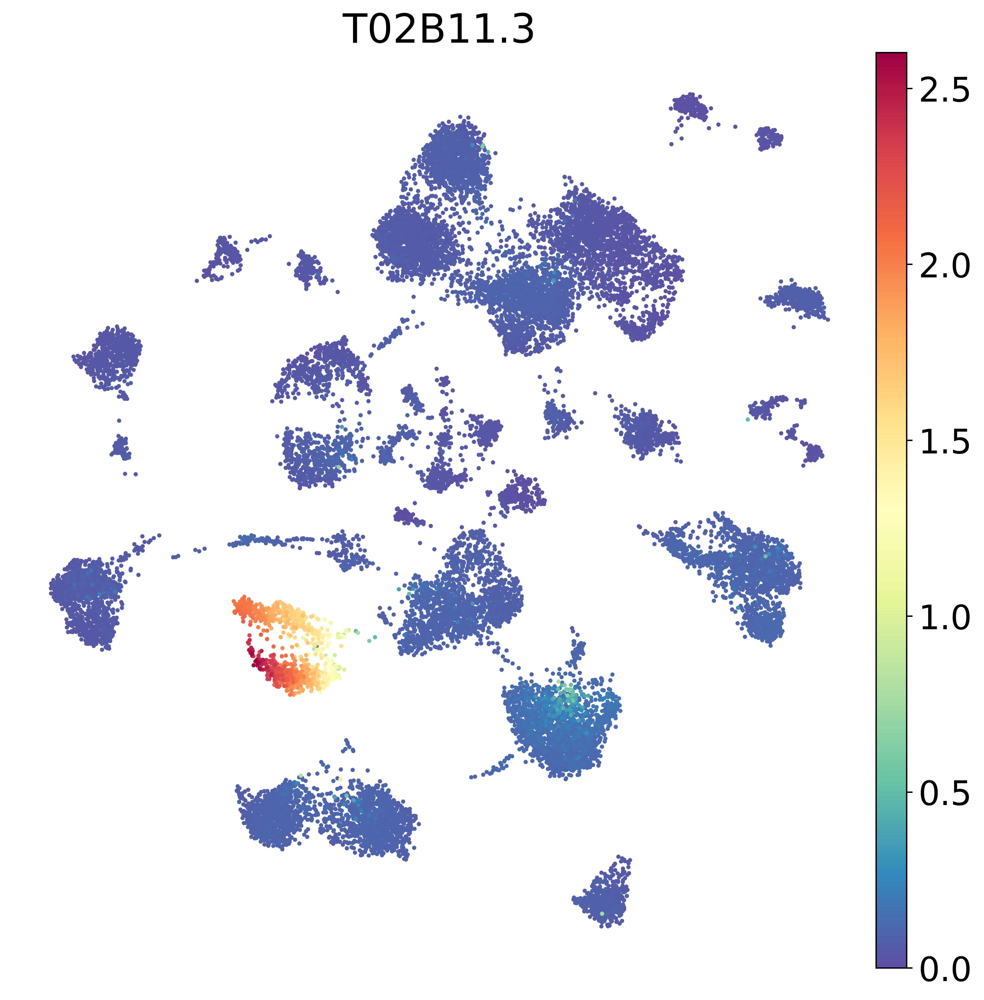

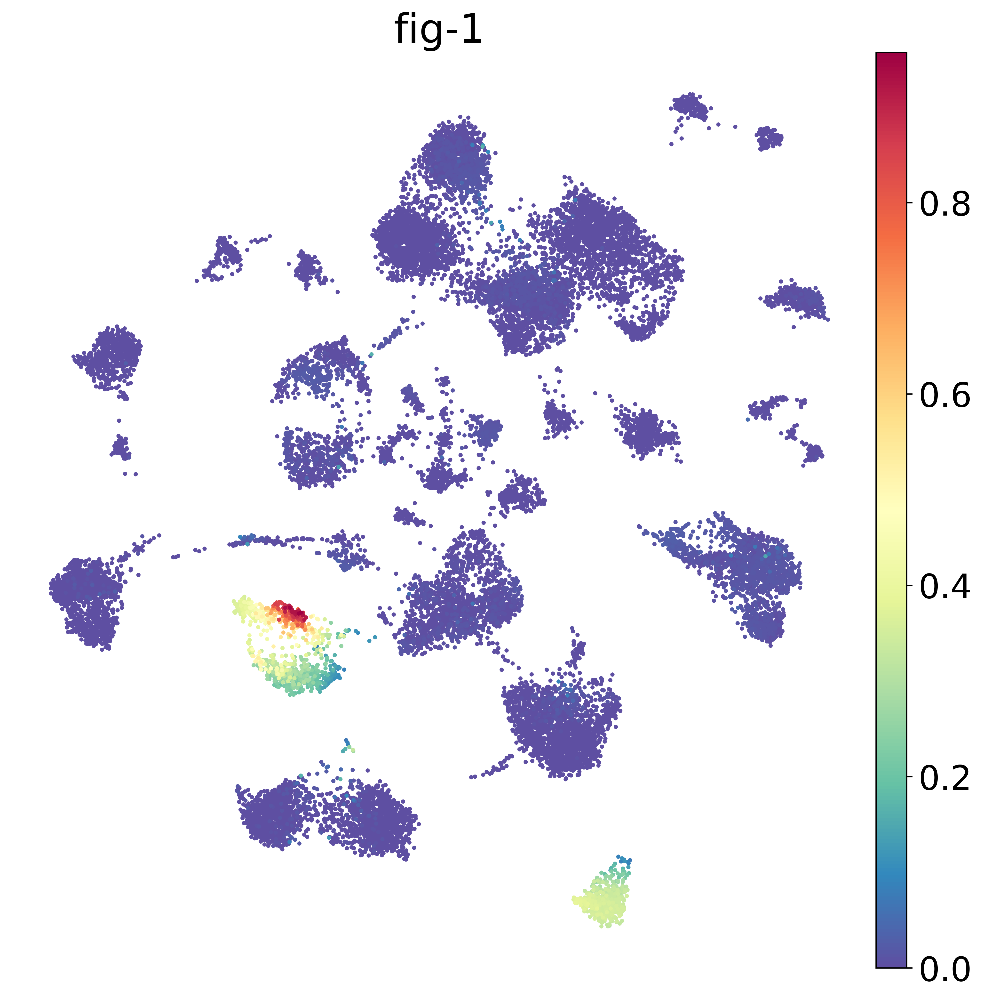

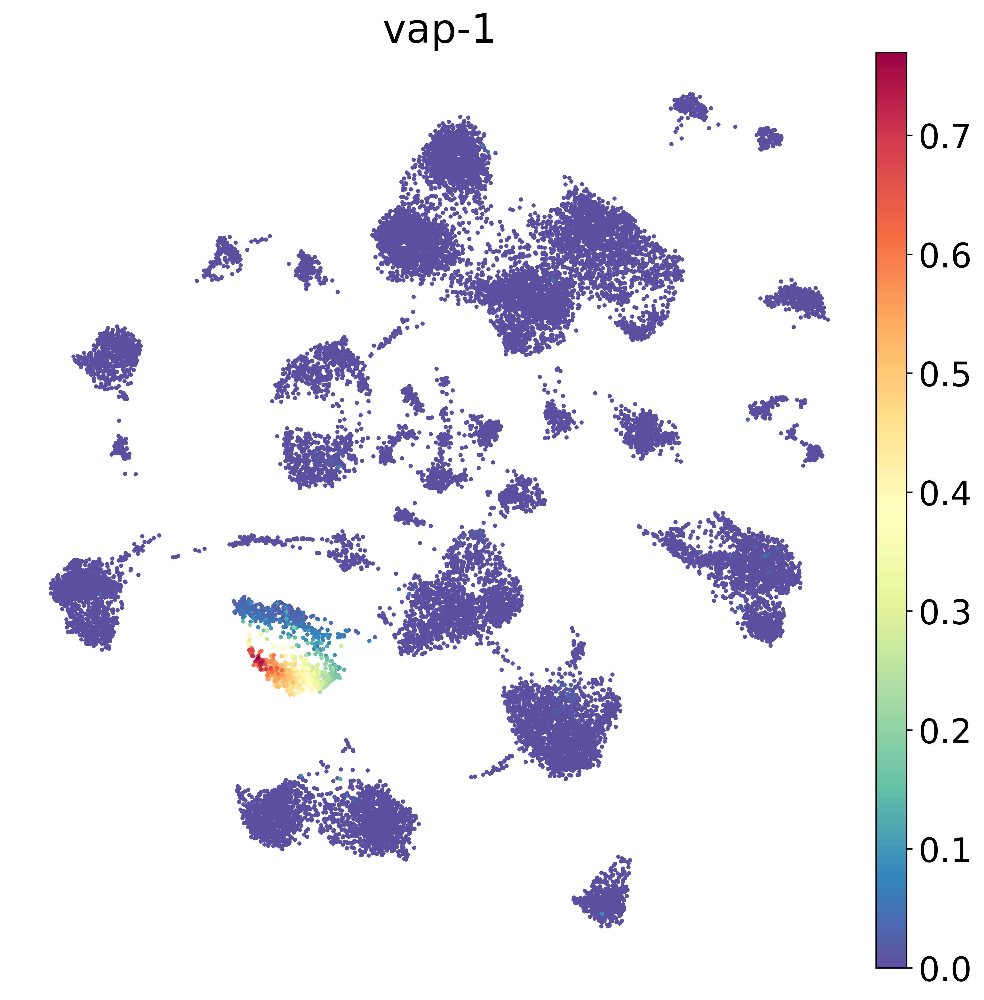

In [8]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['F53F4.13','T02B11.3','fig-1','vap-1']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2C_{gene}.png',
            layer='magic_imputed_postBC'
        )

# SFig 2D -- <i>ZK822.4</i> Expression

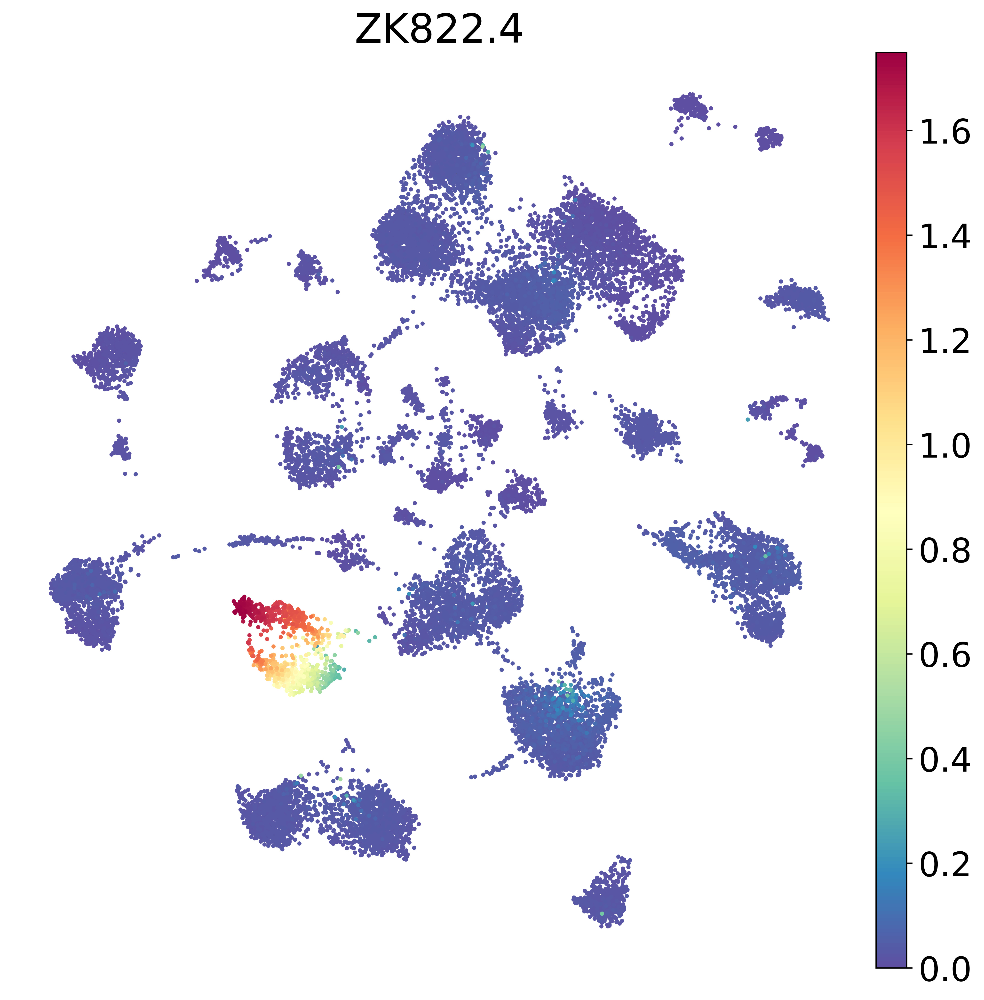

In [9]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['ZK822.4'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2D_{gene}.png',
            layer='magic_imputed_postBC',
        )

# SFig 2E -- <i>vap-1</i>  Cluster 10 Expression

In [10]:
# color cluster 10 by the following: sexes vap-1 expression, vap-1 (+ve), vap-1 (-ve)
adata_amph = adata[adata.obs['Celltype'] == 'AMsh/PHsh',:].copy()

# distribution of vap-1 genes
vap_1_clust10 = pd.DataFrame(adata_amph[:,'vap-1'].X.toarray(), columns=['vap-1_unimputed_expression'], index=adata_amph.obs_names)
vap_1_clust10.loc[:,'vap-1_imputed_expression'] = adata_amph[:,'vap-1'].layers['magic_imputed_postBC'].copy()
threshold=0.125

# vap-1 (+ve) & (-ve) cut off -- using imputed gene exp
vap_cutoffs = vap_1_clust10.index[vap_1_clust10['vap-1_imputed_expression'] < threshold] # False=Phasmid, True=Amphis

# add annotations to metadata
adata_amph.obs.loc[:,'vap_labels'] = adata_amph.obs_names.map(lambda x: 'vap-1 (-ve)' if x in vap_cutoffs else 'vap-1 (+ve)')

# set colors for these new categories
vap_positive, vap_negative = 'red', 'blue'
adata_amph.uns['vap_labels_colors'] = [vap_positive, vap_negative]

In [11]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size':20.0}):
    sc.pl.umap(
        adata_amph,
        color=['leiden_postBC','sex','vap-1','vap_labels'],
        frameon=False,
        size=DOT_SIZE + 500,
        layer='magic_imputed_postBC',
        save='figure_S2E_vap-1_cluster10_thresholding_results.png',
        legend_loc=None
    )

In [12]:
# fraction of herm/male in vap-1 negative cells
# adata_amph.obs.loc[adata_amph.obs['vap_labels'] == 'vap-1 (-ve)','sex'].to_frame()
vap_cells = adata_amph.obs.loc[:,['sex','vap_labels']]
vap_cells = vap_cells.groupby('vap_labels')['sex'].value_counts(normalize=True).unstack(fill_value=0)
vap_cells.reset_index(inplace=True)
vap_cells.head()

,vap_labels,Hermaphrodite,Male
0,vap-1 (+ve),0.666667,0.333333
1,vap-1 (-ve),0.919271,0.080729


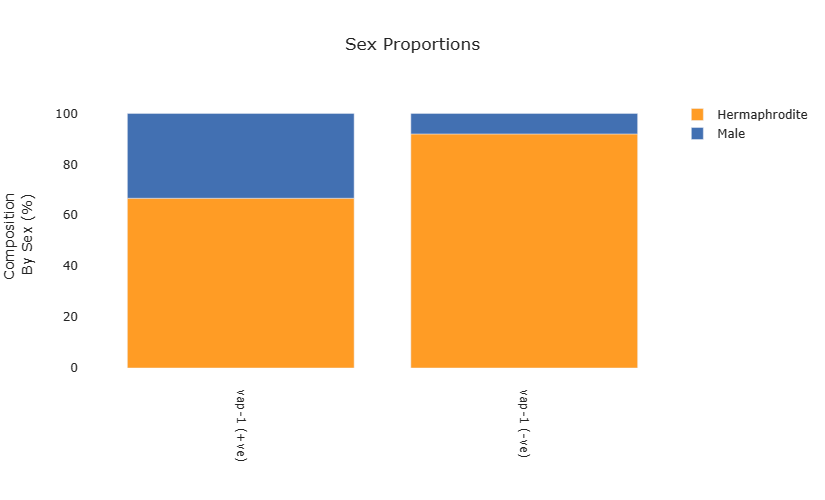

In [13]:
# plot the fractions stored in the data
fig_frac = go.Figure()
bar_colors = {'Male':MALE_COLOR, 'Hermaphrodite':HERM_COLOR}

for sex in ['Hermaphrodite','Male']:
    fig_frac.add_traces(
        go.Bar(
            x=vap_cells.loc[:,'vap_labels'],
            y=vap_cells.loc[:,sex] * 100,
            name=sex,
            marker_color=bar_colors[sex]
        )
    )
fig_frac.update_traces(
    opacity=0.85
)
fig_frac.update_layout(
    template='seaborn',
    width=400,
    height=500,
    barmode='relative',
    hovermode='x unified',
    xaxis=dict(title='',showgrid=False),
    yaxis=dict(title='Composition <br>By Sex (%)',showgrid=False),
    plot_bgcolor='rgba(0,0,0,0)',
    title=dict(text='Sex Proportions'),
    margin=dict(pad=20),
)
fig_frac.update_xaxes(tickangle=90)
fig_frac.show()
fig_frac.write_image('figures/S2E_vap-1_ClusterSex_proportion.png')
fig_frac.write_html('figures/S2E_vap-1_ClusterSex_proportion.html')
fig_frac.write_image('figures/S2E_vap-1_ClusterSex_proportion.svg')

# SFig 2F -- Expression of known glial genes

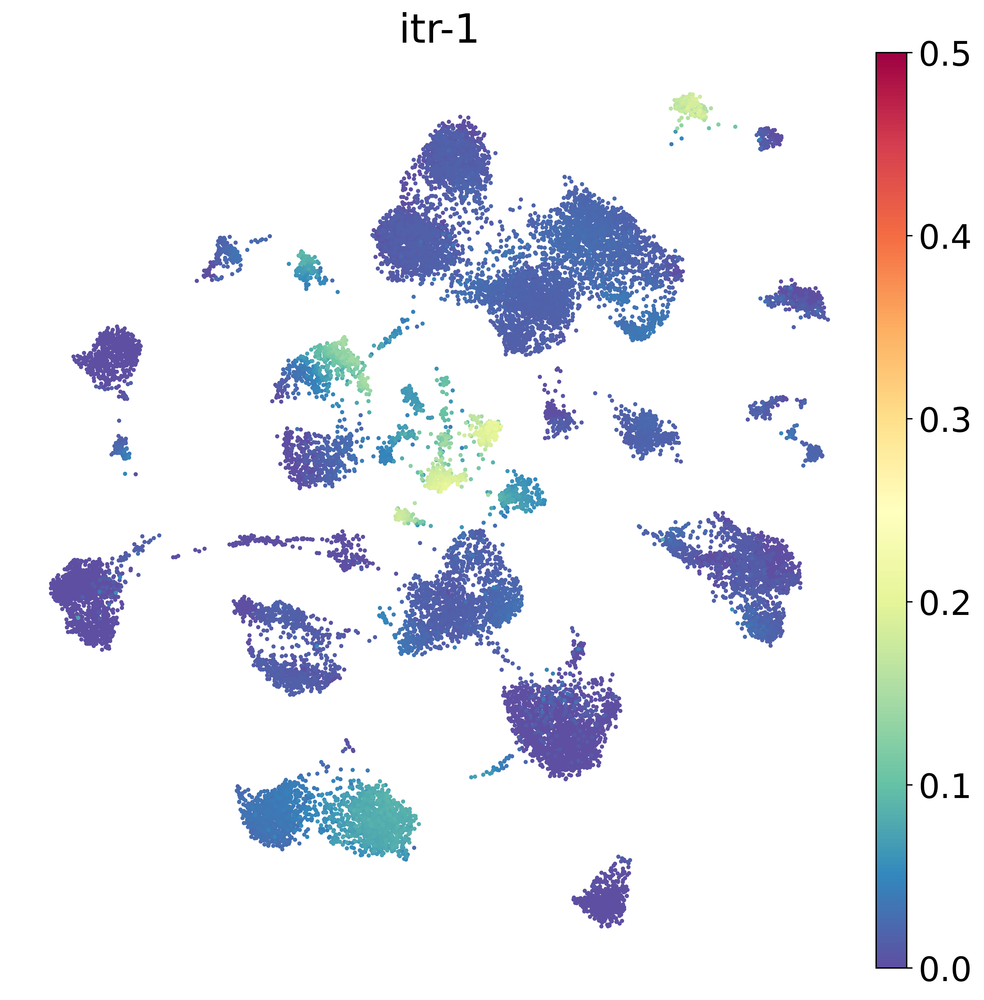

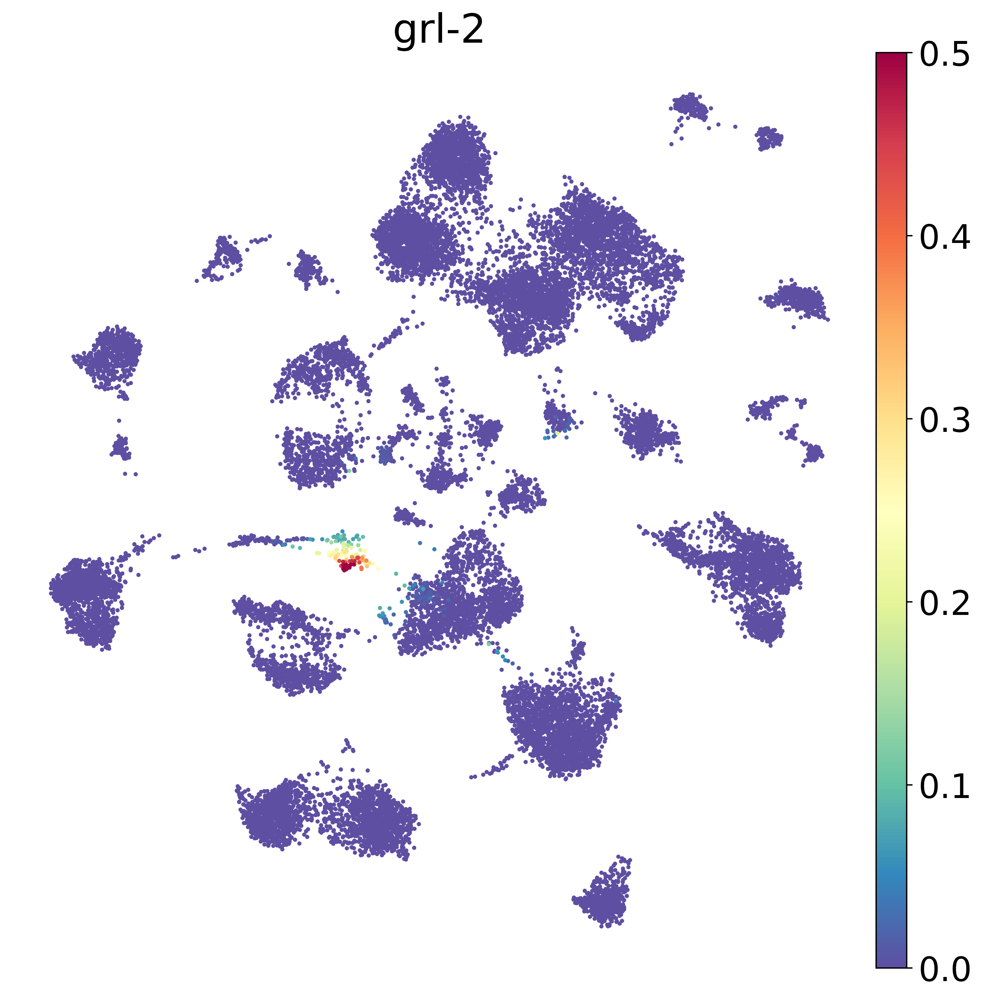

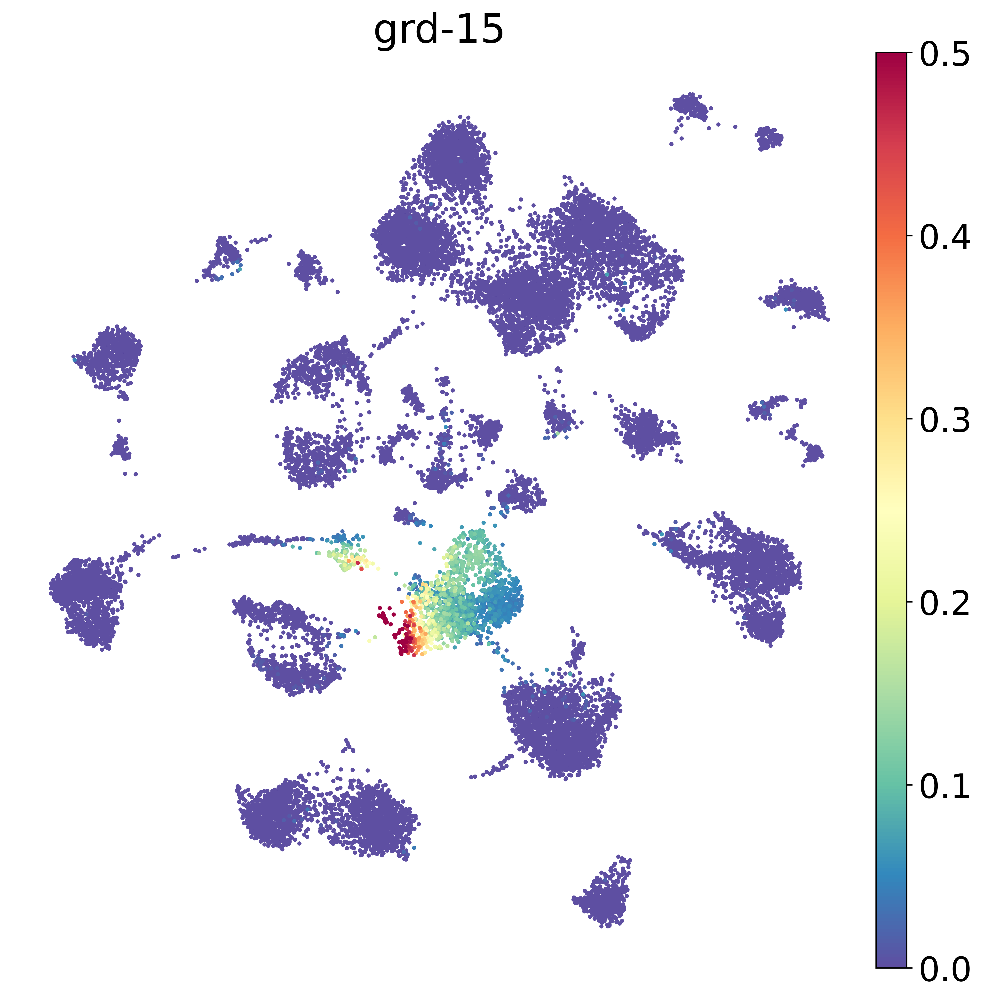

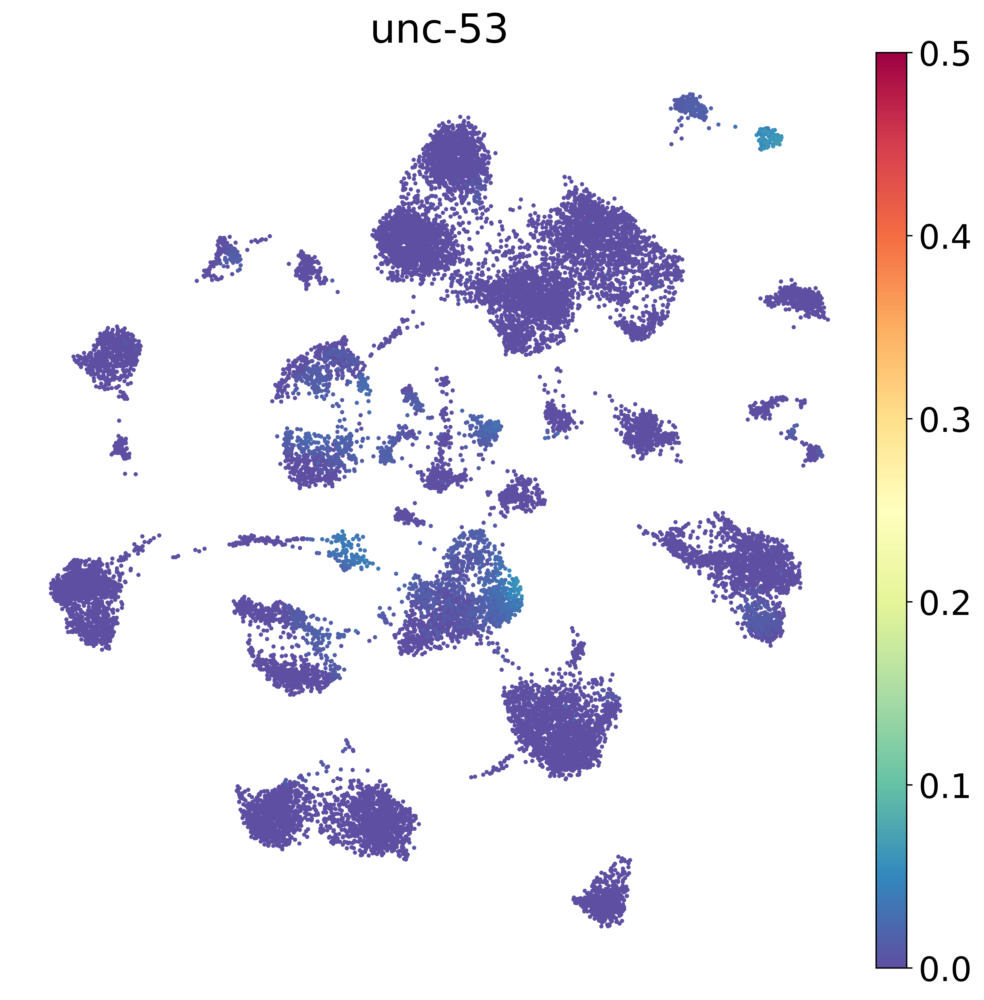

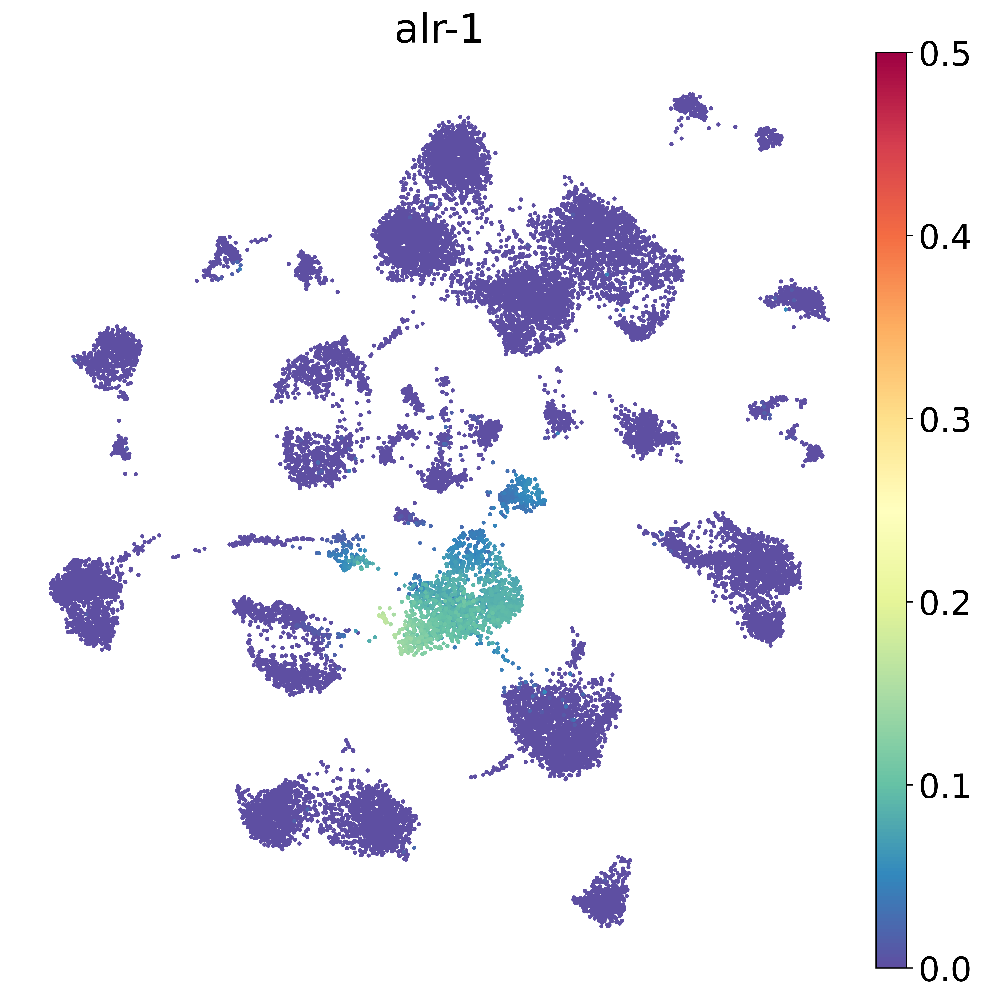

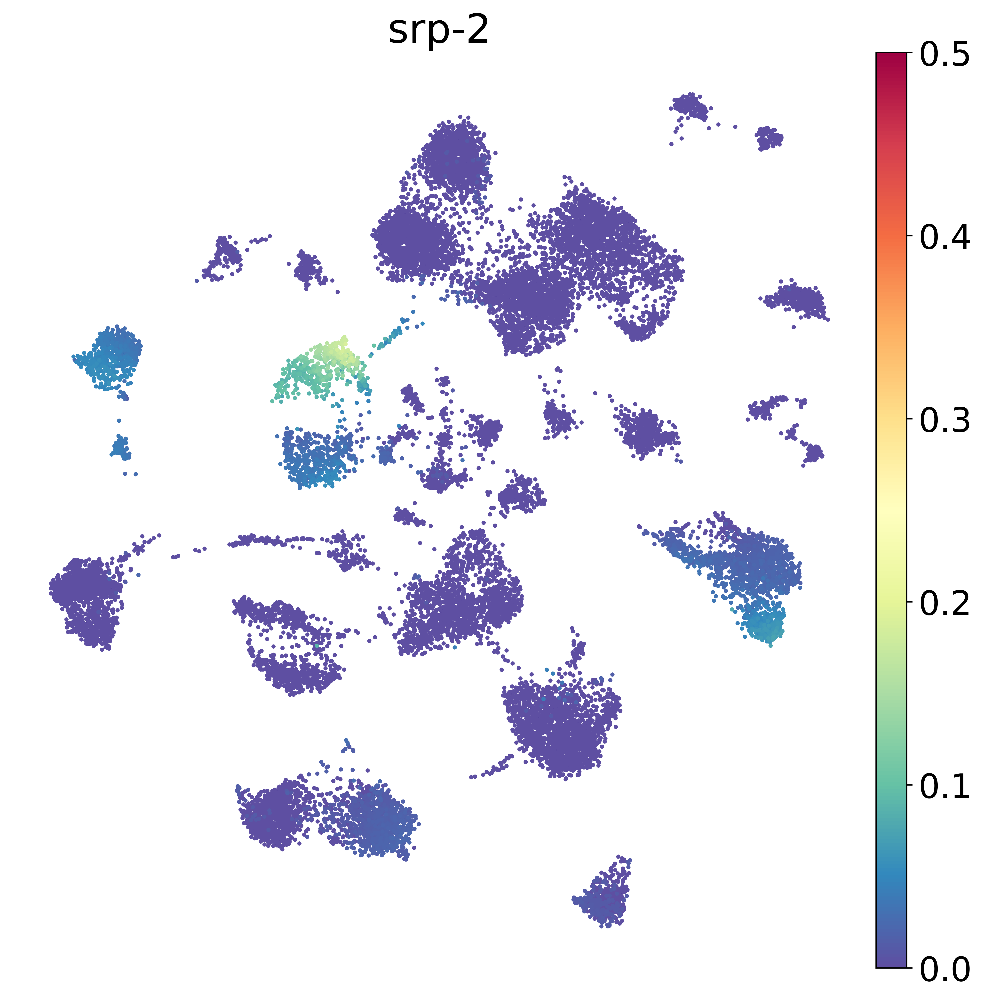

In [14]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
#     PLOT_GENES = ['itr-1','grl-2','lin-48','grd-15','unc-53','alr-1','srp-2'] # abt-4, grl-6 not present
    PLOT_GENES = ['itr-1','grl-2','grd-15','unc-53','alr-1','srp-2'] # abt-4, grl-6 not present
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2F_{gene}.png',
            layer='magic_imputed_postBC',
            vmax=0.5,
            vmin=0.0
        )

# SFig 2G -- <i>Y52E8A.3</i> Expression

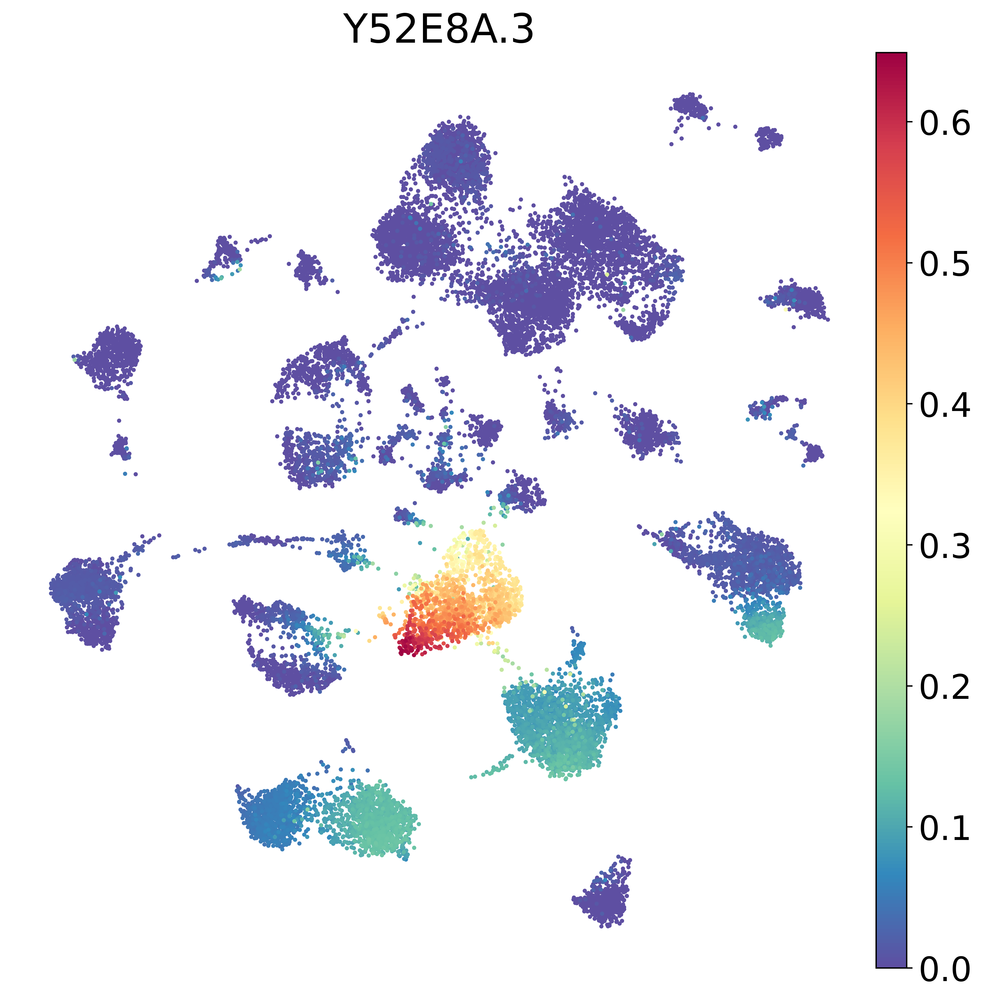

In [15]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE,'font.size': 20.0}):
    PLOT_GENES = ['Y52E8A.3']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2G_{gene}.png',
            layer='magic_imputed_postBC'
        )

# SFig 2H -- <i>lite-1 & lin-48</i> Expression

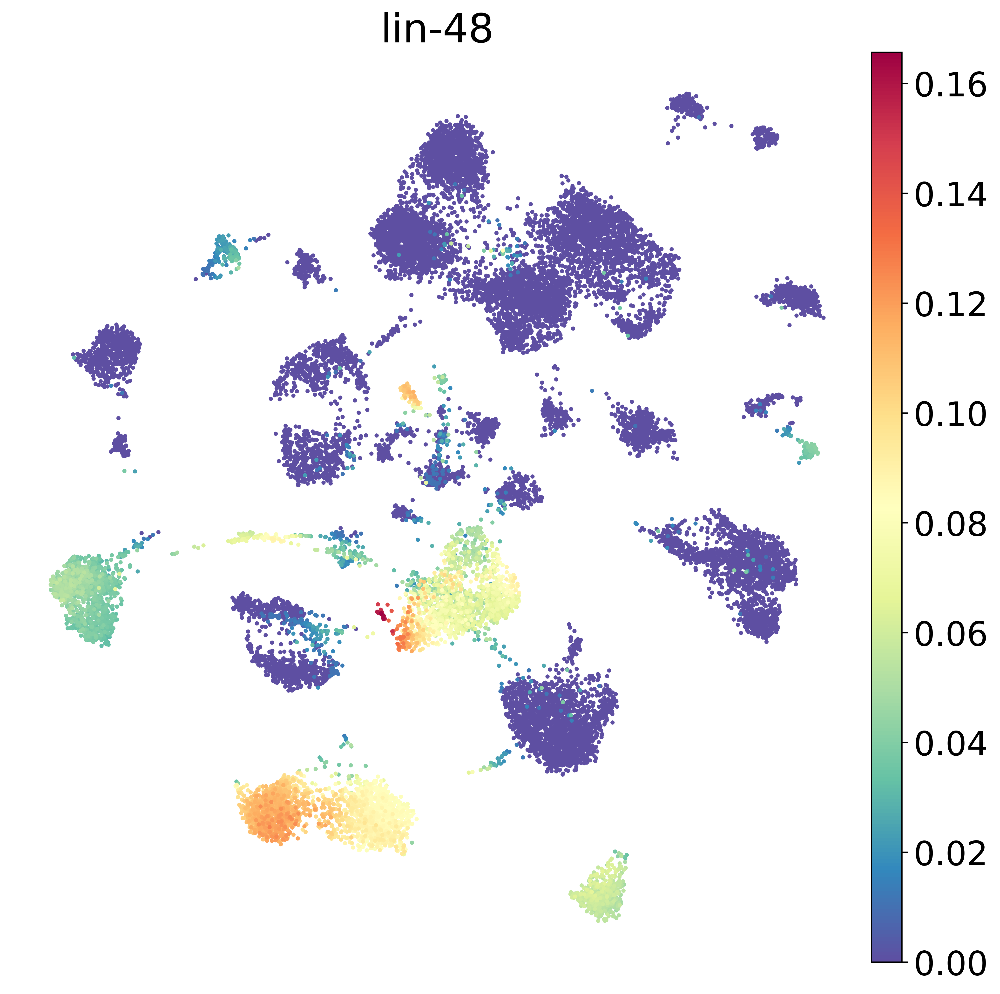

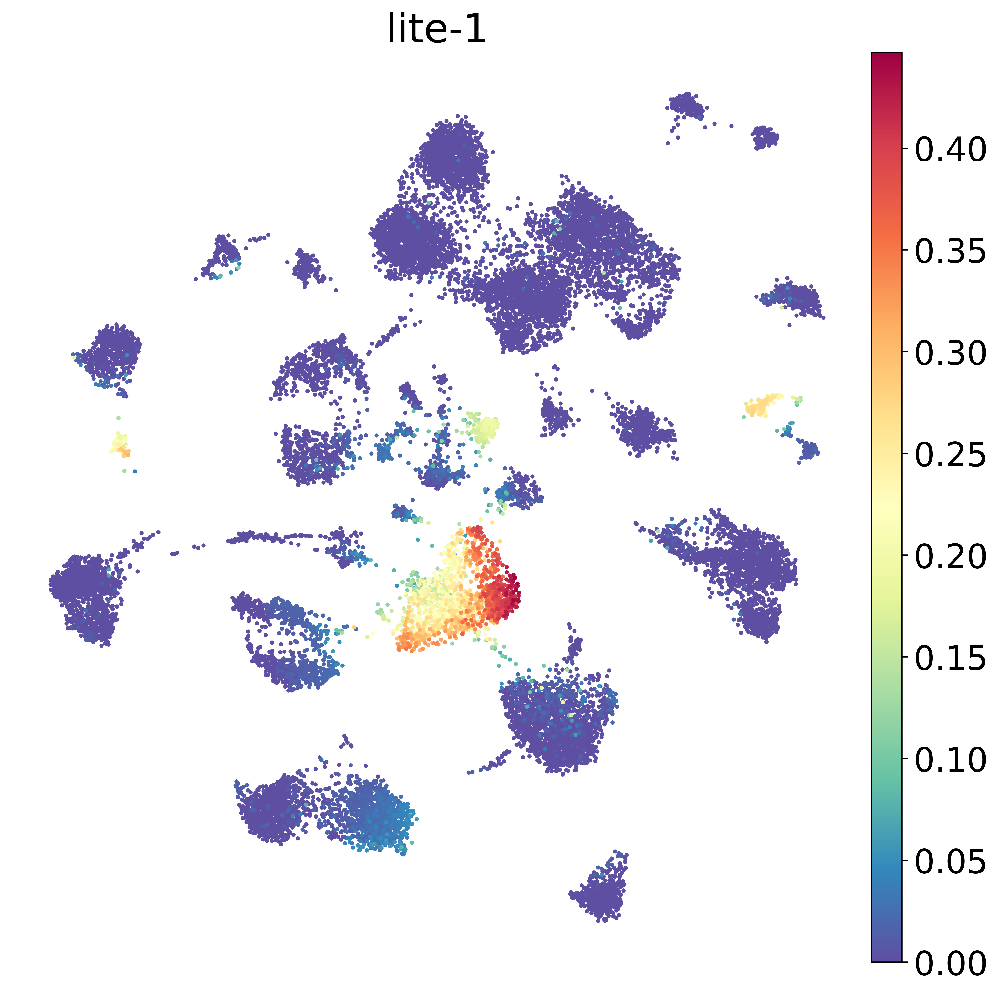

In [16]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE,'font.size': 20.0}):
    PLOT_GENES = ['lin-48','lite-1']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2H_{gene}.png',
            layer='magic_imputed_postBC'
        )

# SFig 2I -- <i>hlh-17, swip-10, twk-16</i> Expression

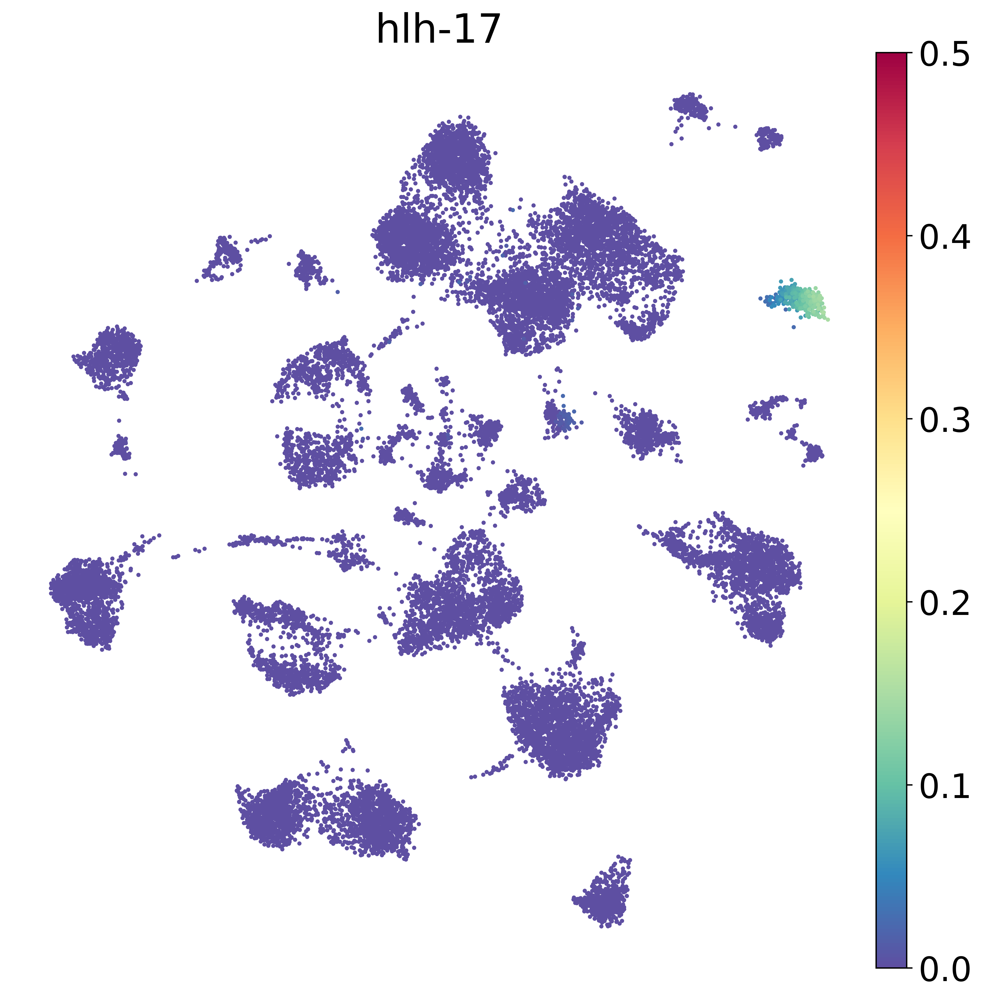

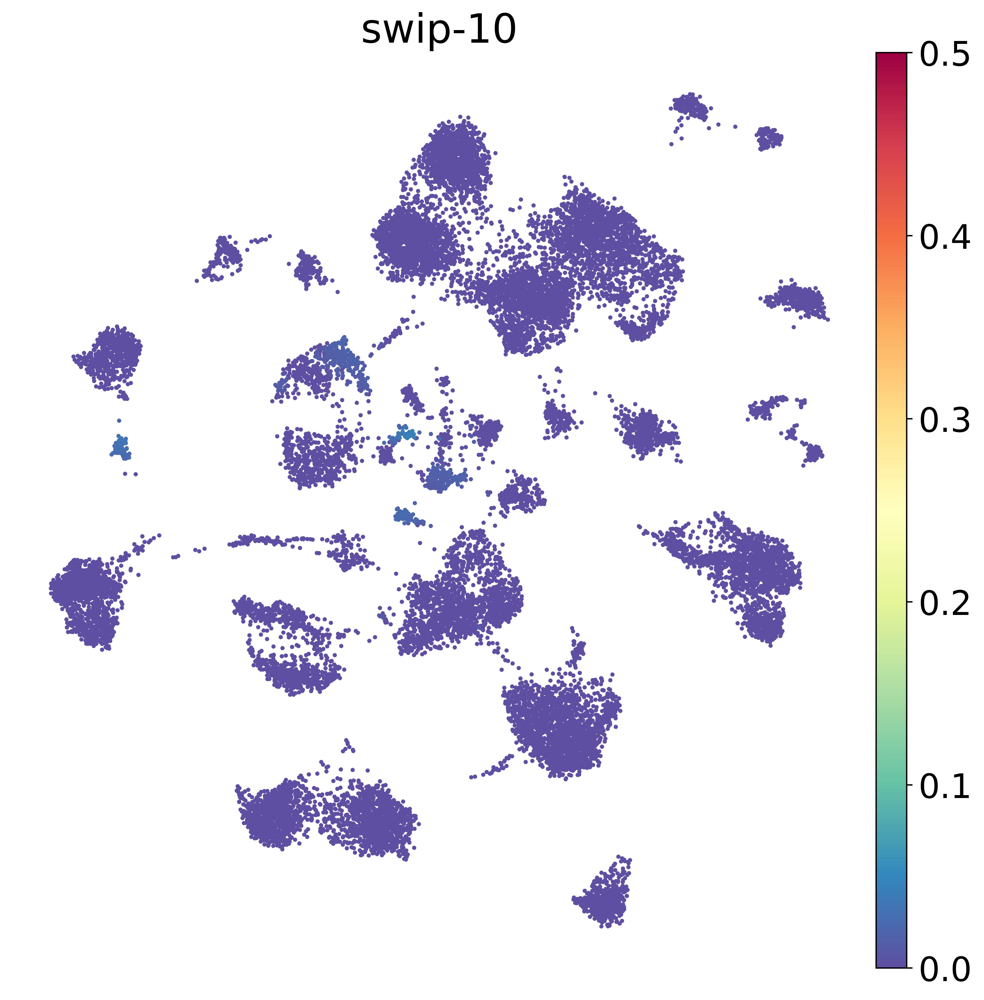

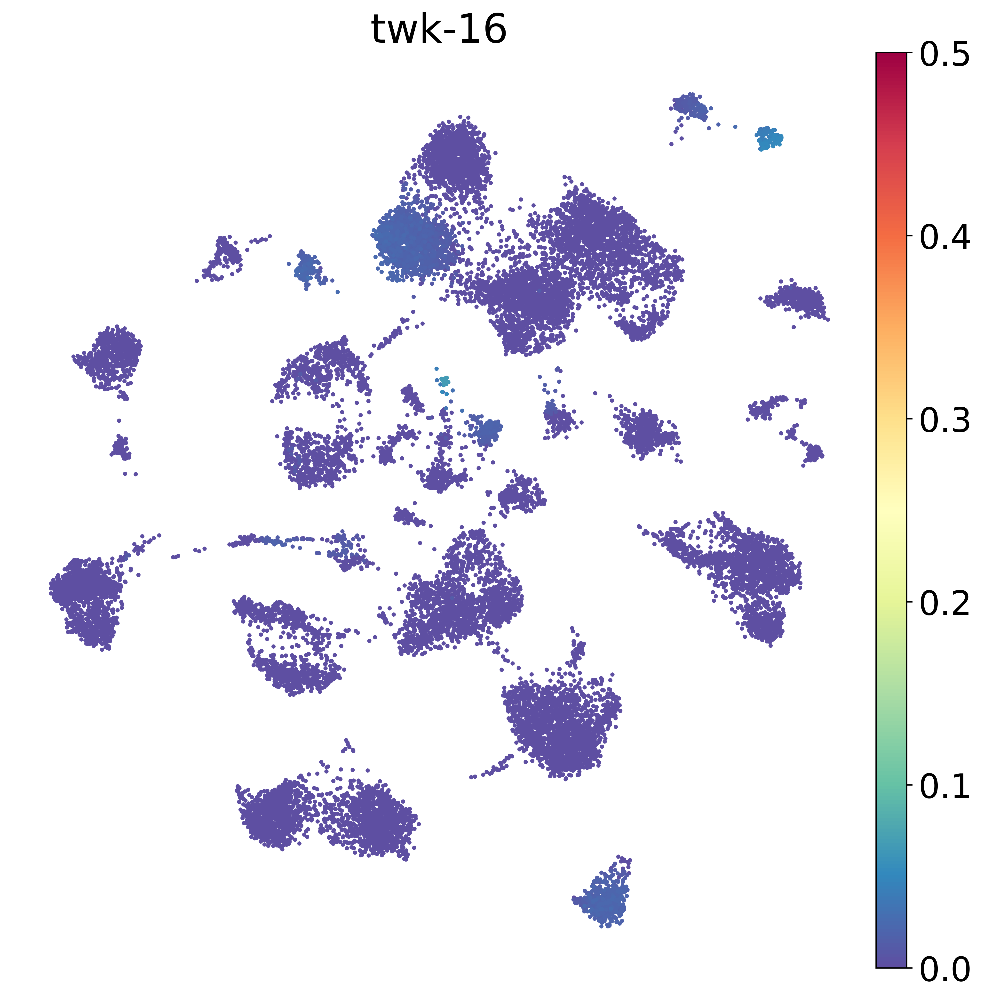

In [17]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE,'font.size': 20.0}):
    PLOT_GENES = ['hlh-17','swip-10','twk-16']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2I_{gene}.png',
            layer='magic_imputed_postBC',
            vmax=0.5,
            vmin=0.0
        )

# SFig 2J -- <i>Y71H10B.1</i> Expression

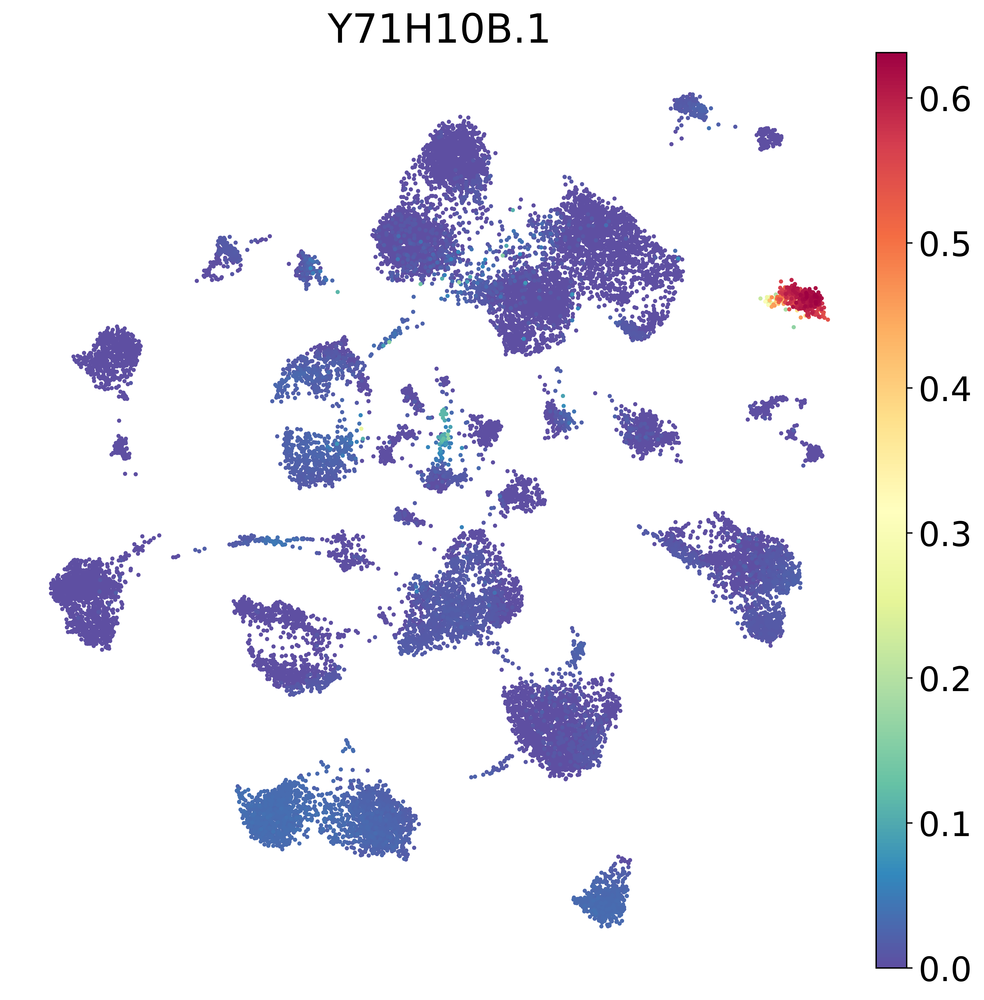

In [18]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE,'font.size': 20.0}):
    PLOT_GENES = ['Y71H10B.1']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2J_{gene}.png',
            layer='magic_imputed_postBC'
        )

# SFig 2K -- <i>grl-18</i> Expression

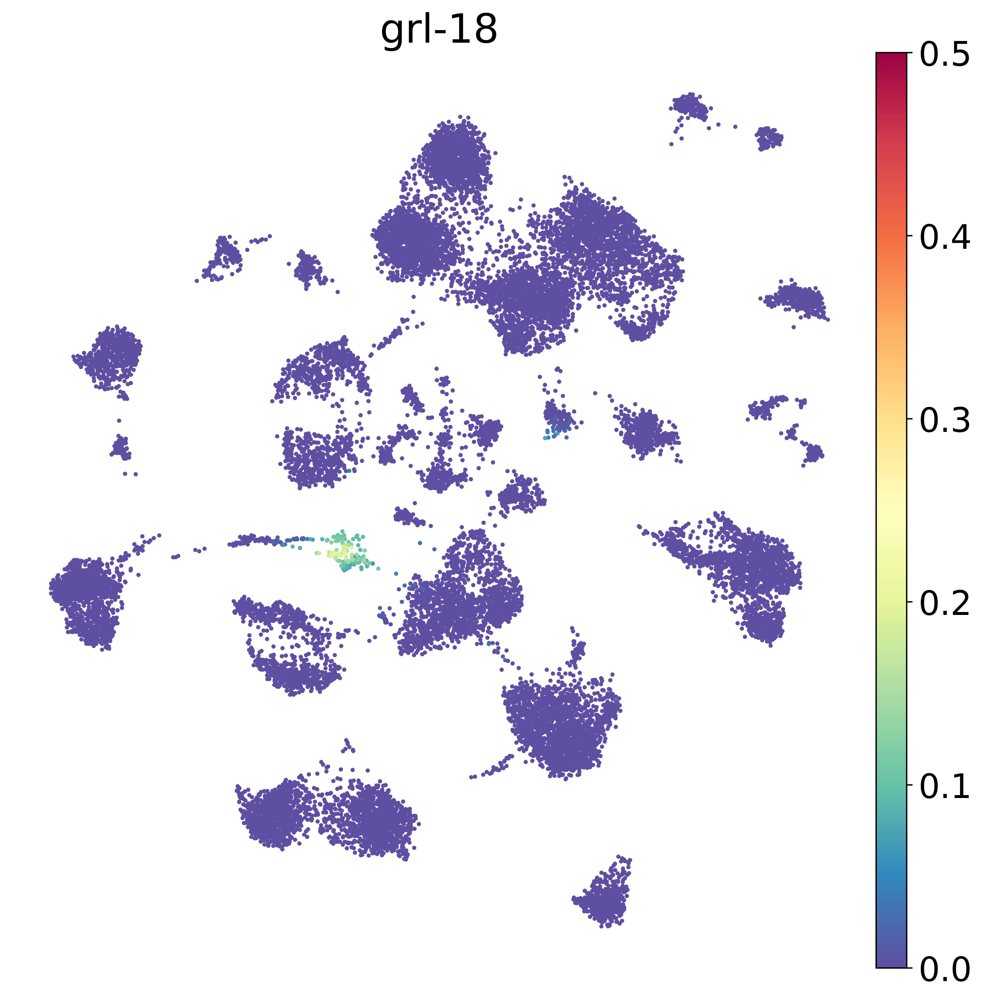

In [19]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE,'font.size': 20.0}):
    PLOT_GENES = ['grl-18']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2K_{gene}.png',
            layer='magic_imputed_postBC',
            vmax=0.5,
            vmin=0.0
        )

# SFig 2L -- <i>col-177 & col-53</i> Expression

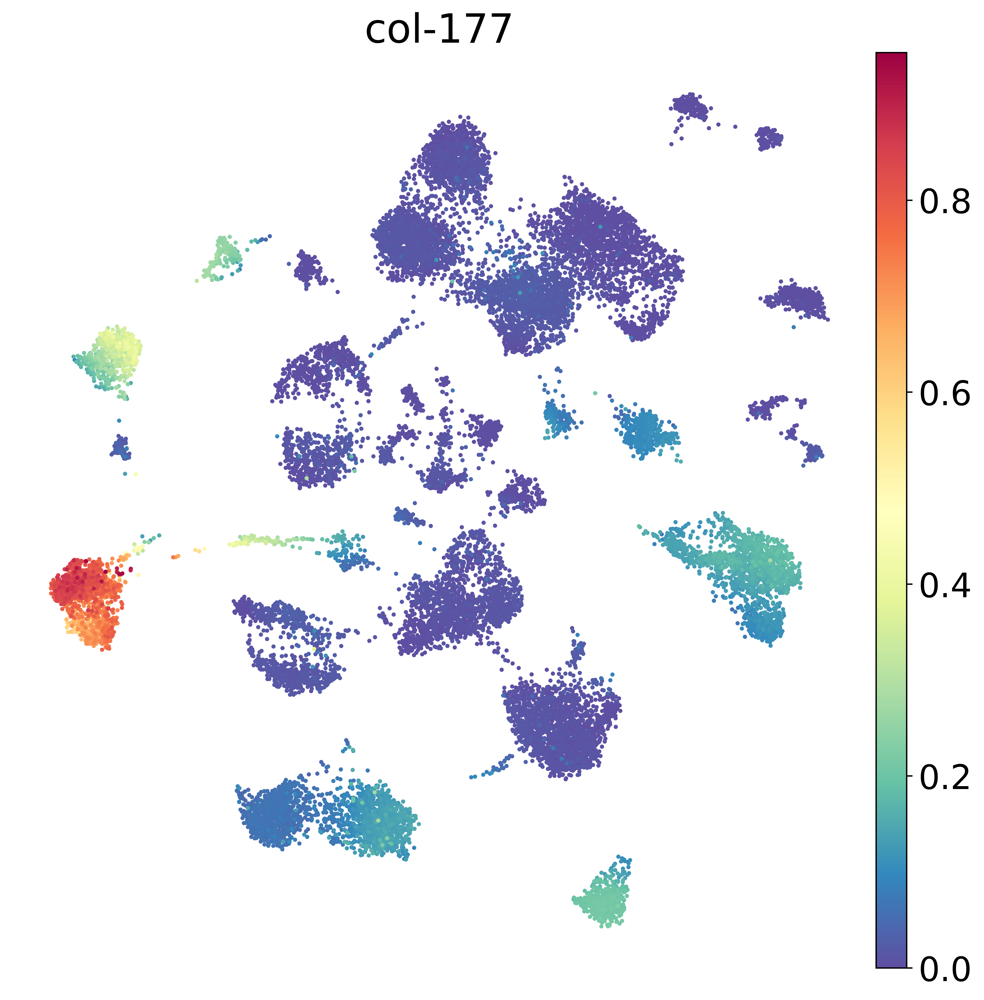

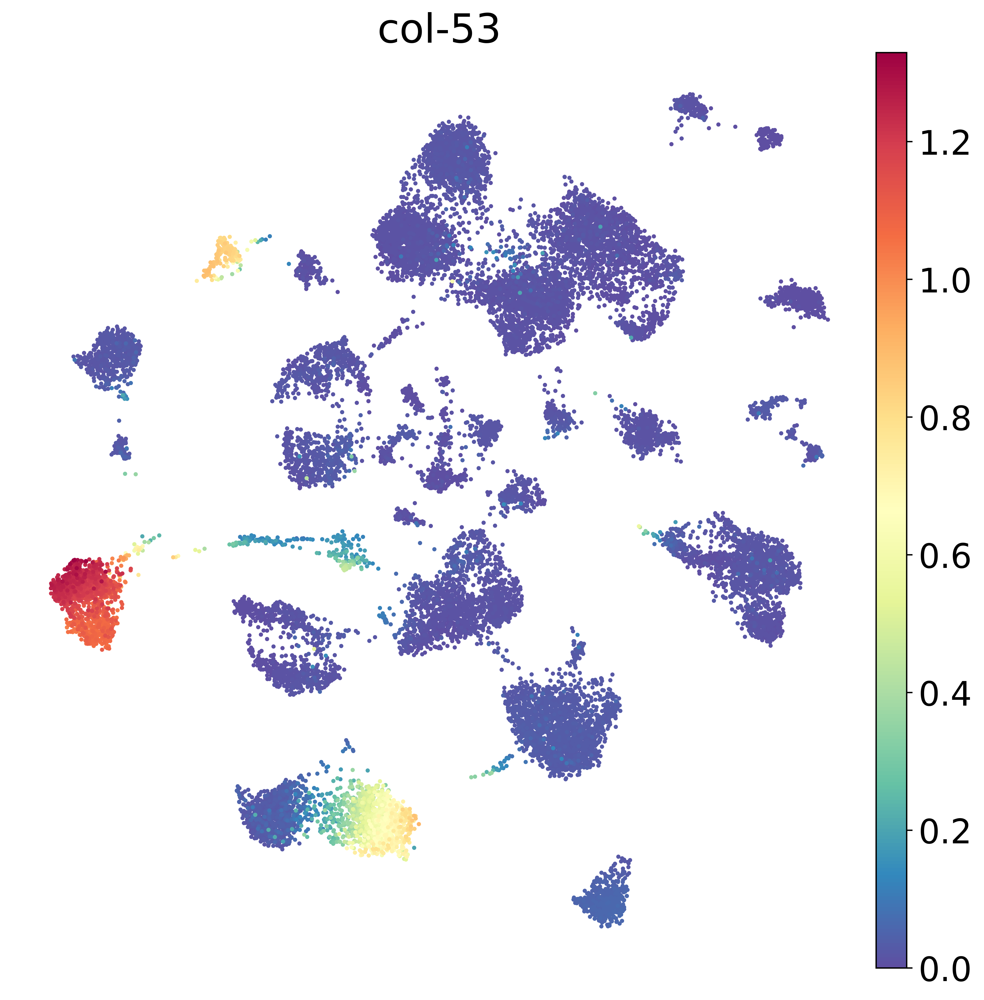

In [20]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE,'font.size': 20.0}):
    PLOT_GENES = ['col-177','col-53']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2L_{gene}.png',
            layer='magic_imputed_postBC',
        )

# SFig 2M -- <i>ptr-10</i> Expression

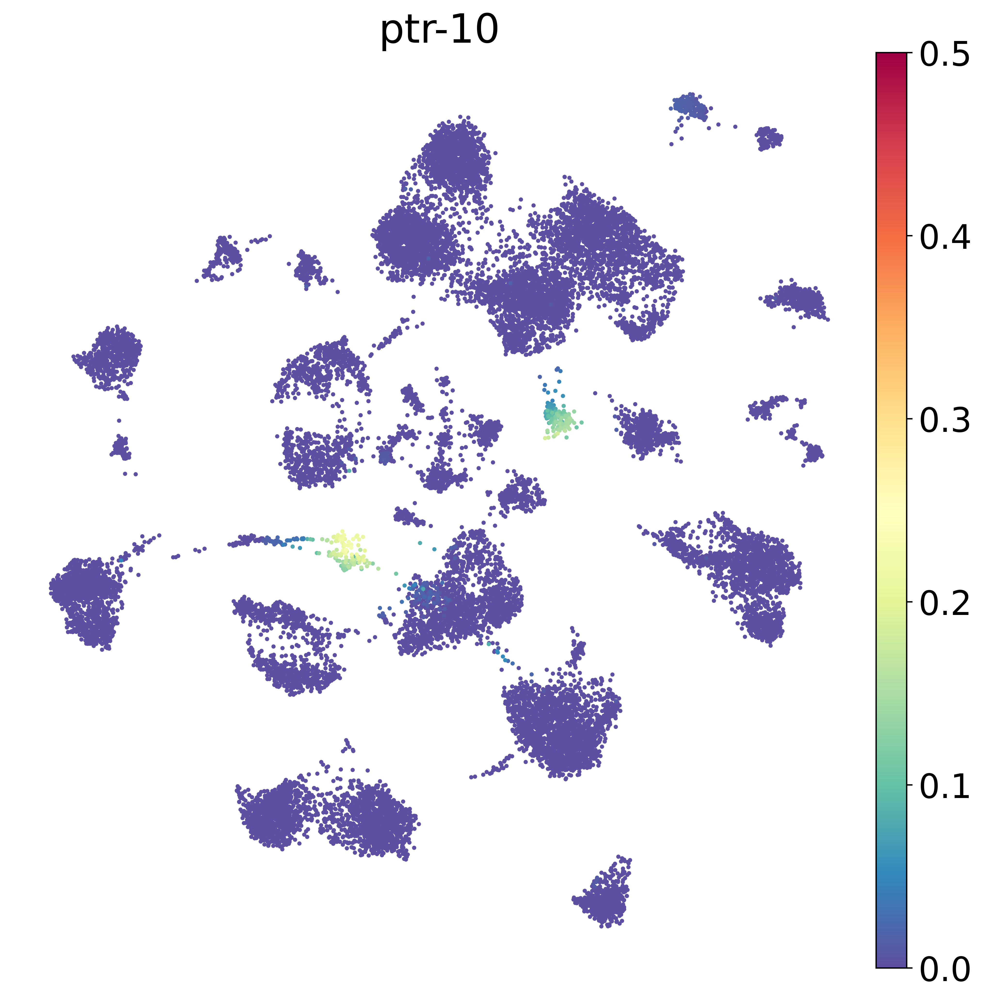

In [21]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE,'font.size': 20.0}):
    PLOT_GENES = ['ptr-10']
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S2M_{gene}.png',
            layer='magic_imputed_postBC',
            vmax=0.5,
            vmin=0.0
        )